In [1]:
import cv2
import numpy as np
import os
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import io

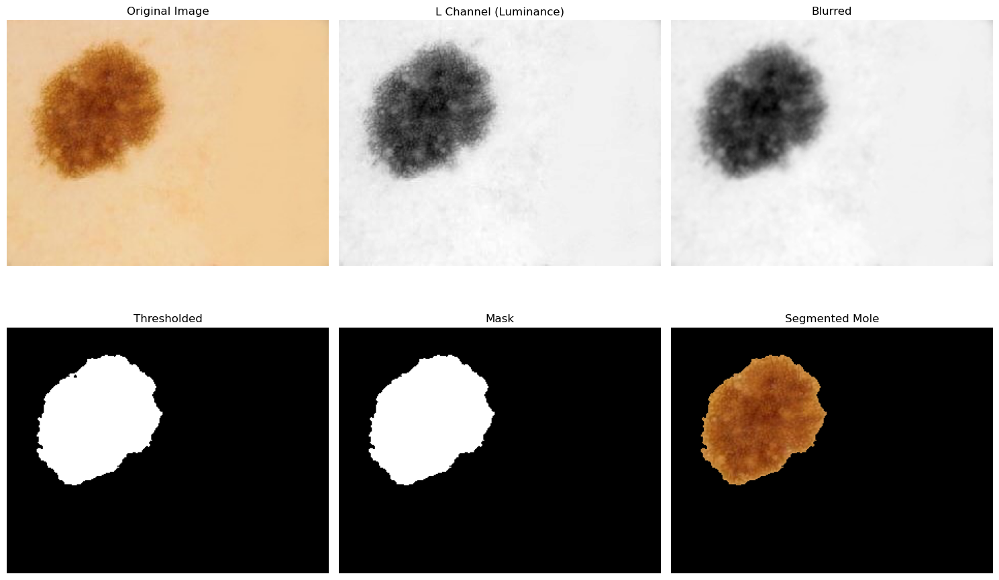

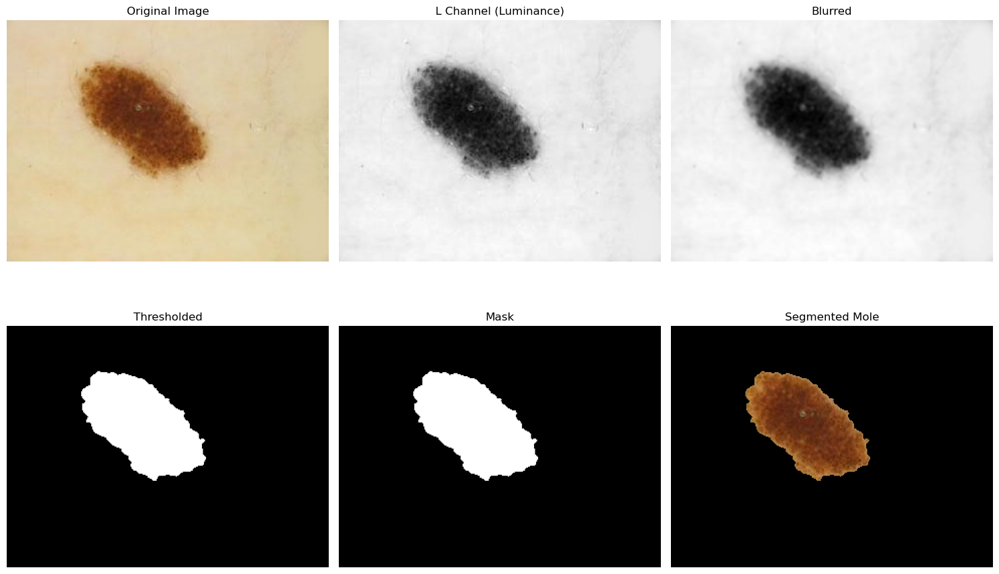

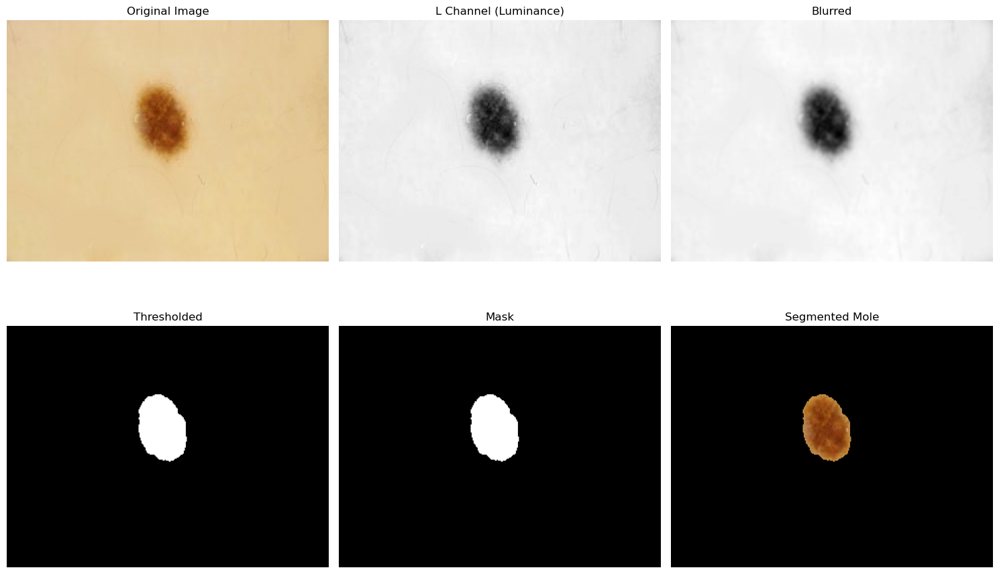

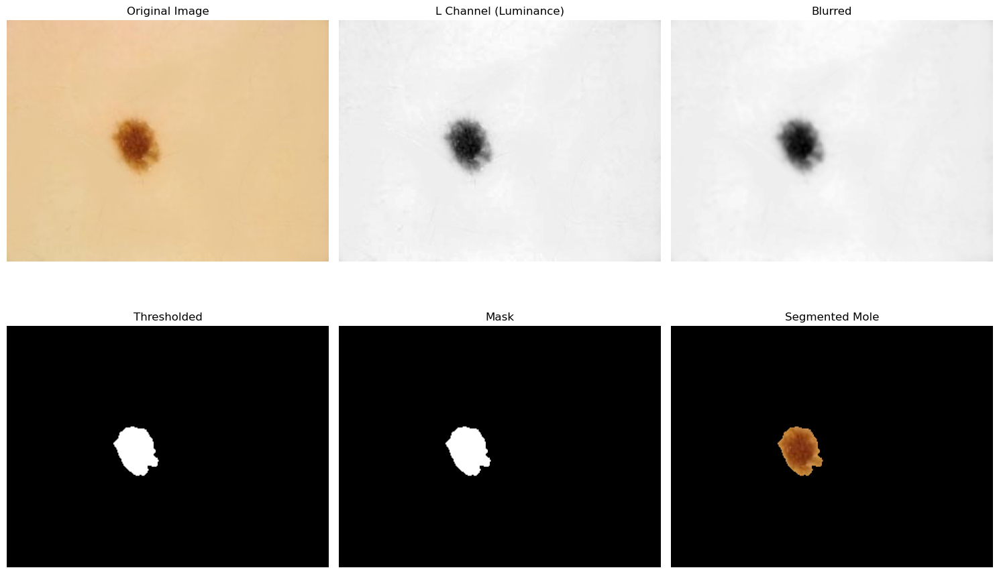

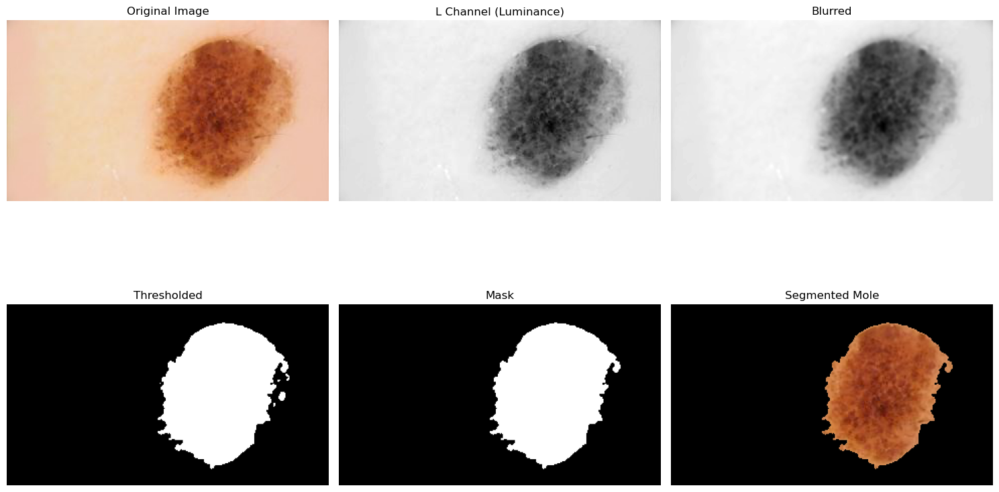

...

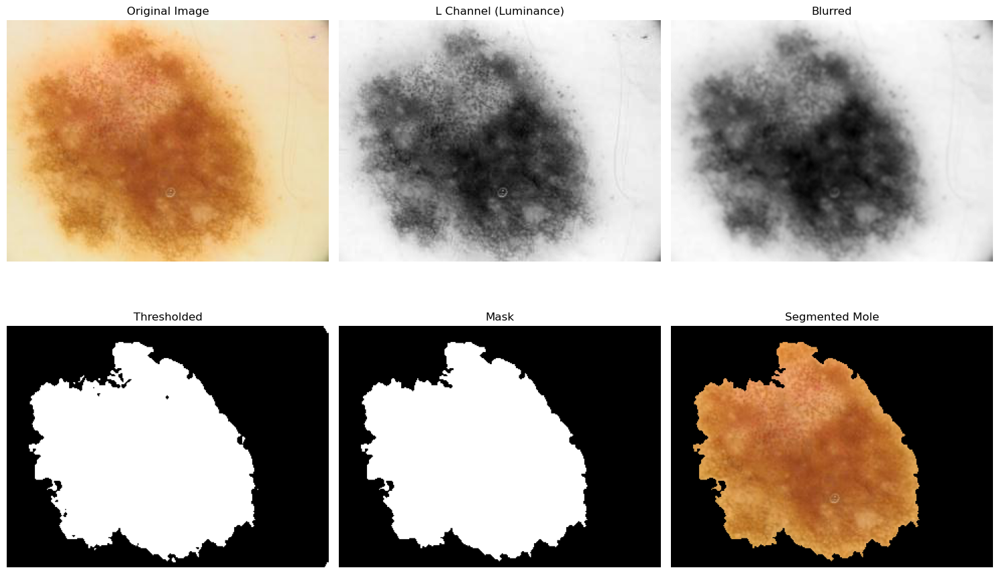

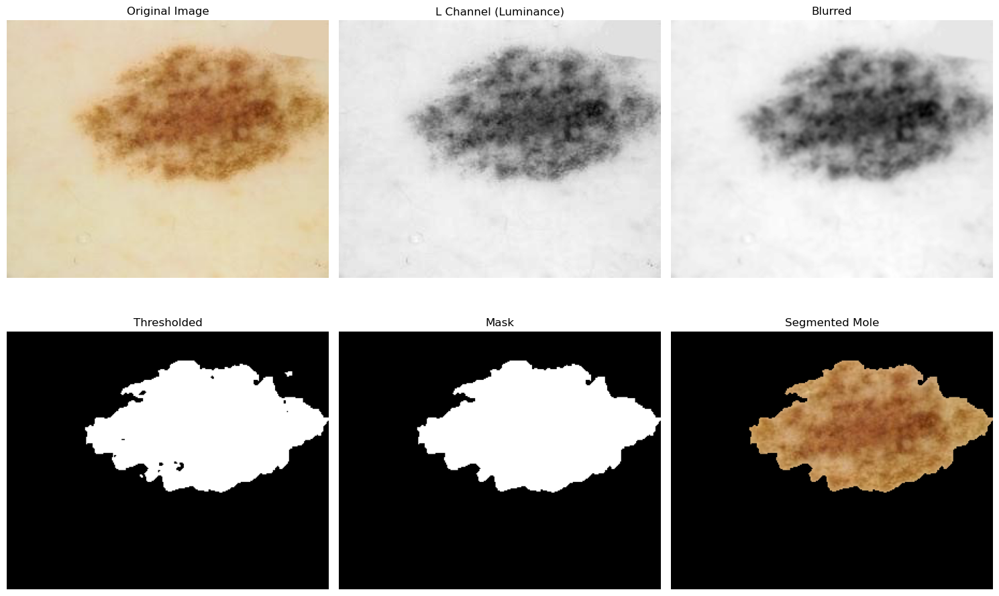

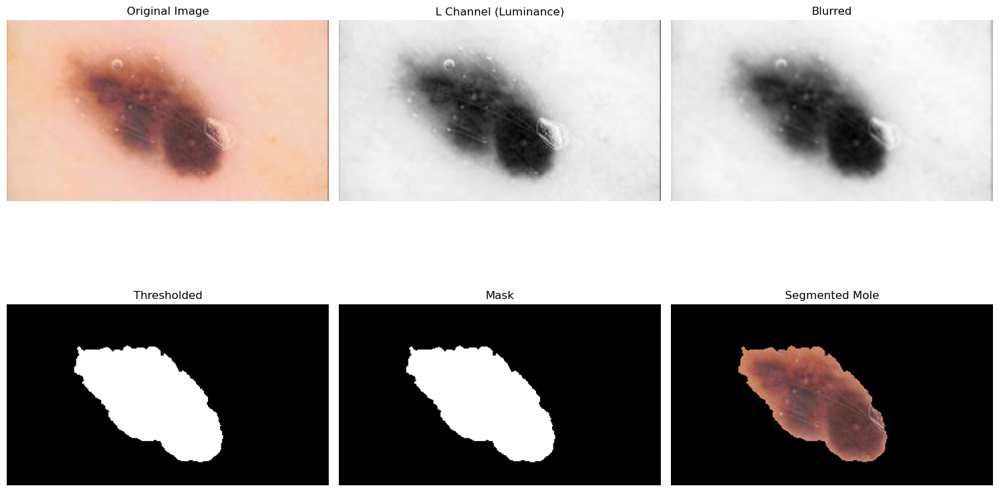

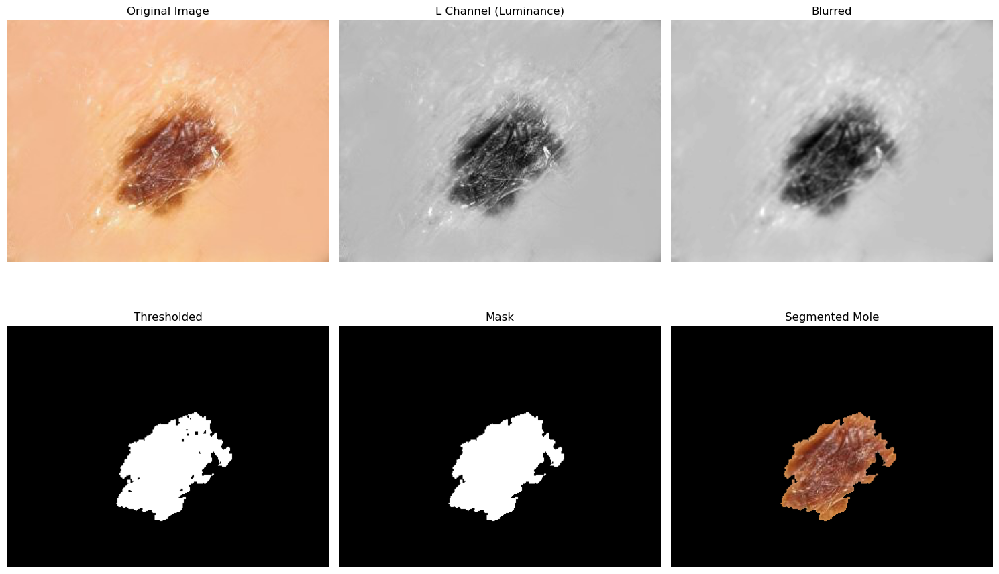

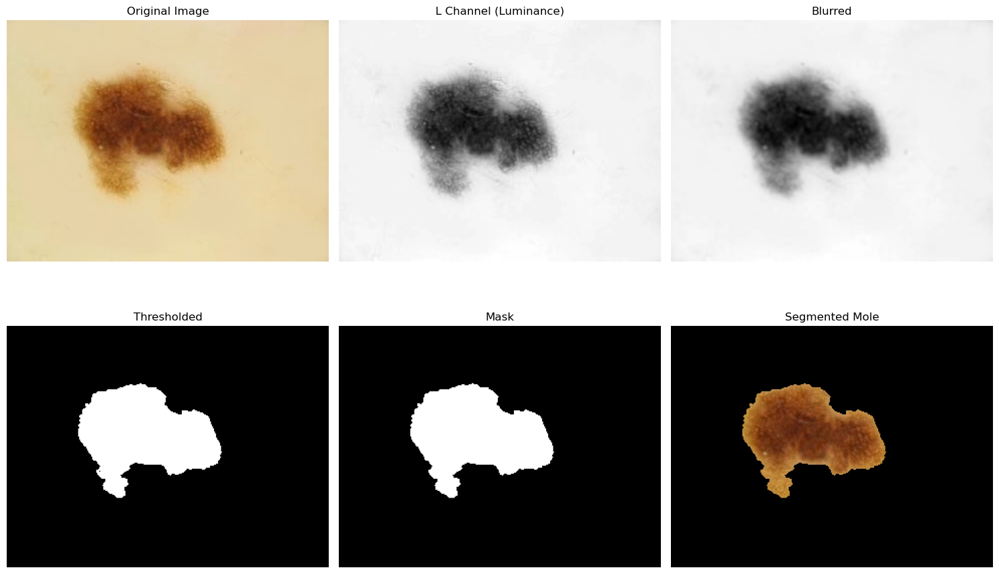

In [2]:


def visualize_segmentation_steps_xyz(image_path, save_path):
    image = io.imread(image_path)  
    
    xyz_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    
    Y_channel = xyz_image[:, :, 0]  
    
      """ Gaussian Blur to reduce noise. Helps reduce the impact of small variations in pixel intensity. 
    Y_channel - input, (5,5) - the size of the kernel (the are of the image that will be taken into account when blurring, 0 depicts std. deviation of Gaussian kernel following the X axis.
     """
    blurred = cv2.GaussianBlur(Y_channel, (5, 5), 0)
    
       """ 0 (thresh) - threshold value to be used in the thresholding operation
        0 tells OpenCV to automatically determine the optimal threshold value based on the image histogram. maxval (255) specifies the maximum value to be assigned
        to pixels exceeding the threshold. Any pixel value above the determined threshold will be set to 255(white) in the output binary image.
        type od thresholding (cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU). cv2.THRESH_BINARY_INV inverts the binary image (pixels above the threshold will be set 
        to 0(black) and pixels below the threshold will be set to 255(white), as seen on the visualization below. cv2.THRESH_OTSU - automatically
        calculates the optimal threshold value based on the image histogram, separating the pixel values into two classes(foreground and background)
    """
    _, thresholded = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    
    """ Moving on with detection contours in a binary image (thresholded, pixels are either 0(black) or 255 (white). Contours are curved joining all the continuous points along a boundary that have 
    the same colour or intensity. mode - determines how the contours are retrieved. (cv2.RETR_EXTERNAL) retrieves only rhe extrenal contours of objects in the image. 
    This is useful when only the outermost boundaries of shapes need to be detected, ignoring any details of holes or nested contours within (the moles).
    method - specifies how the contour points are approximated. cv2.CHAIN_APPROX_SIMPLE - compresses horizontal, vertical and diagonal segments and leaves 
    only their endpoints. 
    """
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    """ The largest contour is the mole area.  Contours is a list of all the contours found in the image, obtained in the previous step. cv2.contourArea
     - is an OpenCV function that computes the are of a given contour. We pass key=cv2.contourArea to max() to evaluate each contour based on its area.
    """
    largest_contour = max(contours, key=cv2.contourArea)
    
    """ mask = np.zeros_like(Y_channel) creates a new image(mask) that is the same size and shape as the Y_channel but filled with zeros(black). 
    np.zeros_like generates an array of zeros with the same shape and type as the input array (Y_channel). The purpose of this mask is to serve as a blank
    canvas where the contours will be drawn, allowing to isolate the mole from the backround. 
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED) - draws the largest contour onto the previosly created mask. mask - the image 
    where the contour will be drawn. [largest_contour] - a list containing the contour to be drawn (largest one found earlier). -1: specifies which contours to draw.
    Since there's only one(the largest), that one is going to be drawn. 255: the color to be used for drawing (white). thickness=cv2.FILLED: how the contour 
    should be drawn. cv2.FILLED - the contour is filled completely. 
    """
    mask = np.zeros_like(Y_channel)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)
    
    """ cv2.bitwise_and() - performs a bitwise AND operation on two images. it compares each pixel of the two images and returns a new image where each 
    pixel is the result of the AND operation. It is applied to the same image twice, using the mask to control which parts of the image are RETAINED.
    """
    mole_segmented = cv2.bitwise_and(image, image, mask=mask)
    mole_segmented_bgr = cv2.cvtColor(mole_segmented, cv2.COLOR_RGB2BGR)

    """ saving all the segmented mole images with size 300X300 """
    #mole_segmented_resized = cv2.resize(mole_segmented_bgr, (300,300))
    #cv2.imwrite(save_path, mole_segmented_resized)

    x, y, w, h = cv2.boundingRect(largest_contour)

       
    cropped_mole = mole_segmented_bgr[y:y+h, x:x+w]
    mole_segmented_resized = cv2.resize(cropped_mole, (300, 300))
    
    cv2.imwrite(save_path, mole_segmented_resized)

    
    titles = ['Original Image', 'L Channel (Luminance)', 'Blurred', 'Thresholded', 'Mask', 'Segmented Mole']
    images = [image, Y_channel, blurred, thresholded, mask, mole_segmented]

    plt.figure(figsize=(15, 10))

    for i, img in enumerate(images):
        plt.subplot(2, 3, i + 1)
        if img.ndim == 2:  
            plt.imshow(img, cmap='gray')
        else:  # Color images
            plt.imshow(img)  
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()


benign_folder = r"C:\Users\Mia\Desktop\kpgm\Benign"
malignant_folder = r"C:\Users\Mia\Desktop\kpgm\Malignant"

save_benign_folder = r"C:\Users\Mia\Desktop\kpgm\Benign\YCbCr"
save_malignant_folder = r"C:\Users\Mia\Desktop\kpgm\Malignant\YCbCr"


for filename in os.listdir(benign_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(benign_folder, filename)
        save_path = os.path.join(save_benign_folder, filename)
        visualize_segmentation_steps_xyz(image_path, save_path)

for filename in os.listdir(malignant_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(malignant_folder, filename)
        save_path = os.path.join(save_malignant_folder, filename)
        visualize_segmentation_steps_xyz(image_path, save_path)


## Box counting ##

In [ ]:
benign_folder = r'C:\Users\Mia\Desktop\kpgm\Benign\XYZ'benign_folder = r'C:\Users\Mia\Desktop\kpgm\Benign\XYZ'